In [4]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [5]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"dilshanmanathunge1","key":"fc014c241f571b0a5a07bdf6a469c01a"}'}

##<h1>Dataset</h1>

In [6]:
! pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [7]:
!kaggle datasets download tongpython/cat-and-dog -p "/content/gdrive/MyDrive/Applied AI/Cat-colorizer"

 96% 209M/218M [00:01<00:00, 136MB/s]
100% 218M/218M [00:01<00:00, 145MB/s]


In [9]:
import glob, os
os.chdir("/content/gdrive/MyDrive/Applied AI/Cat-colorizer")

In [10]:
!unzip cat-and-dog -d "/content/gdrive/MyDrive/Applied AI/Cat-colorizer/data"

Streaming output truncated to the last 5000 lines.
  inflating: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set/cats/cat.3704.jpg  
  inflating: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set/cats/cat.3705.jpg  
  inflating: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set/cats/cat.3706.jpg  
  inflating: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set/cats/cat.3707.jpg  
  inflating: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set/cats/cat.3708.jpg  
  inflating: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set/cats/cat.3709.jpg  
  inflating: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set/cats/cat.371.jpg  
  inflating: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set/cats/cat.3710.jpg  
  inflating: /content/gdrive/MyDrive/Applied A

##Implimentation

In [125]:
from tensorflow import keras
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input
from tensorflow.keras.layers import Conv2D, UpSampling2D, InputLayer, Conv2DTranspose, Input, Reshape, concatenate, Layer ,BatchNormalization
from tensorflow.keras.layers import Activation, Dense, Dropout, Flatten
from tensorflow.keras.callbacks import TensorBoard 
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import RepeatVector,Permute
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from skimage.color import rgb2lab, lab2rgb, rgb2gray, gray2rgb
from skimage.transform import resize
from skimage.io import imsave
import numpy as np
import os
import random
import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import cv2
from PIL import Image

In [2]:

image_size =256

In [3]:

trainPath ="/content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/training_set/training_set"

testPath ="/content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/test_set/test_set"


In [5]:
inception = InceptionResNetV2(weights="imagenet", include_top=True)

225222656/225209952 [==============================] - 2s 0us/step


In [6]:
batch_size=64

In [7]:
datagen = ImageDataGenerator(
        shear_range=0.2,
        zoom_range=0.2,
        rotation_range=20,
        horizontal_flip=True, rescale=1./255,validation_split=0.2)

In [8]:
trainGenerator = datagen.flow_from_directory(trainPath,target_size=(image_size,image_size),batch_size=batch_size,class_mode=None,classes=["cats"])

Found 4000 images belonging to 1 classes.


In [9]:
def image_a_b_gen(generator):
  for image in generator:
    lab_image = rgb2lab(image)
    luminance = lab_image[:,:,:,[0]]
    ab_components = lab_image[:,:,:,1:]/ 128
    embedding = createEmmdeding(image)
    #luminance= luminance.reshape(luminance.shape+(1,))
   
    yield([luminance,embedding],ab_components)

In [10]:
def createEmmdeding(image):
  grayscaled = gray2rgb(rgb2gray(image))
  resized_grayscaled = []
  for i in  grayscaled:
    resizeImage = resize(i,(299,299,3),mode="constant")
    resized_grayscaled.append(resizeImage)
  imageArray = np.array(resized_grayscaled)
  imageArray = preprocess_input(imageArray)
  embedding = inception.predict(imageArray)
  return embedding

In [11]:
embedded_input = Input(shape=(1000,))

In [12]:
#Model 

encoder_input = Input(shape=(256, 256, 1,))
encoder_output = Conv2D(64, (3,3), activation='relu', padding='same', strides=2)(encoder_input)
encoder_output = Conv2D(128, (3,3), activation='relu', padding='same')(encoder_output)
encoder_output = Conv2D(128, (3,3), activation='relu', padding='same', strides=2)(encoder_output)
encoder_output = Conv2D(256, (3,3), activation='relu', padding='same')(encoder_output)
encoder_output = Conv2D(256, (3,3), activation='relu', padding='same', strides=2)(encoder_output)
encoder_output = Conv2D(512, (3,3), activation='relu', padding='same')(encoder_output)
encoder_output = Conv2D(512, (3,3), activation='relu', padding='same')(encoder_output)
encoder_output = Conv2D(256, (3,3), activation='relu', padding='same')(encoder_output)

#Fusion
fusion_output = RepeatVector(32 * 32)(embedded_input) 
fusion_output = Reshape(([32, 32, 1000]))(fusion_output)
fusion_output = concatenate([encoder_output, fusion_output], axis=3) 
fusion_output = Conv2D(256, (1, 1), activation='relu', padding='same')(fusion_output)

#Decoder
decoder_output = Conv2D(128, (3,3), activation='relu', padding='same')(fusion_output)
decoder_output = UpSampling2D((2, 2))(decoder_output)
decoder_output = Conv2D(64, (3,3), activation='relu', padding='same')(decoder_output)
decoder_output = UpSampling2D((2, 2))(decoder_output)
decoder_output = Conv2D(32, (3,3), activation='relu', padding='same')(decoder_output)
decoder_output = Conv2D(16, (3,3), activation='relu', padding='same')(decoder_output)
decoder_output = Conv2D(2, (3, 3), activation='tanh', padding='same')(decoder_output)
decoder_output = UpSampling2D((2, 2))(decoder_output)

model = Model(inputs=[encoder_input, embedded_input], outputs=decoder_output)

In [13]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_203 (Conv2D)            (None, 128, 128, 64  640         ['input_3[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_204 (Conv2D)            (None, 128, 128, 12  73856       ['conv2d_203[0][0]']             
                                8)                                                            

In [59]:
filepath = "/content/gdrive/MyDrive/Applied AI/Cat-colorizer/fusion"
logdir ="/content/gdrive/MyDrive/Applied AI/Cat-colorizer/log"

In [60]:
checkpoint = ModelCheckpoint(filepath, monitor='loss', verbose=1, save_best_only=True, mode='min')
patience = 50
early_stop = EarlyStopping('loss', patience=patience)

board = TensorBoard(log_dir=logdir,histogram_freq=1)
callbacks_list = [checkpoint,early_stop,board]


In [16]:
model.load_weights(filepath)

In [ ]:
#Train model      
model.compile(optimizer = Adam(learning_rate = 0.001), loss = 'mean_absolute_error',
              metrics = ['acc'],run_eagerly=True)
history = model.fit(image_a_b_gen(trainGenerator), epochs=200, steps_per_epoch=62,callbacks=callbacks_list,verbose=1 )


Epoch 1/200
62/62 [==============================] - ETA: 0s - loss: 0.0835 - acc: 0.6436
Epoch 00001: loss improved from inf to 0.08347, saving model to /content/gdrive/MyDrive/Applied AI /catos/models/v2
INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Applied AI /catos/models/v2/assets
62/62 [==============================] - 232s 4s/step - loss: 0.0835 - acc: 0.6436
Epoch 2/200
62/62 [==============================] - ETA: 0s - loss: 0.0520 - acc: 0.6631
Epoch 00002: loss improved from 0.08347 to 0.05202, saving model to /content/gdrive/MyDrive/Applied AI /catos/models/v2
INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Applied AI /catos/models/v2/assets
62/62 [==============================] - 236s 4s/step - loss: 0.0520 - acc: 0.6631
Epoch 3/200
62/62 [==============================] - ETA: 0s - loss: 0.0515 - acc: 0.6611
Epoch 00003: loss improved from 0.05202 to 0.05148, saving model to /content/gdrive/MyDrive/Applied AI /catos/models/v2
INFO:tensorflow:Asse

In [ ]:
#Train model      
model.compile(optimizer = Adam(learning_rate = 0.001), loss = 'mean_absolute_error',
              metrics = ['acc'],run_eagerly=True)
history2 = model.fit(image_a_b_gen(trainGenerator), epochs=200, steps_per_epoch=62,callbacks=callbacks_list,verbose=1,initial_epoch=34)

Epoch 35/200
62/62 [==============================] - ETA: 0s - loss: 0.0507 - acc: 0.6645 
Epoch 00035: loss improved from inf to 0.05068, saving model to /content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/models/fusion
INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/models/fusion/assets
62/62 [==============================] - 1930s 32s/step - loss: 0.0507 - acc: 0.6645
Epoch 36/200
62/62 [==============================] - ETA: 0s - loss: 0.0507 - acc: 0.6632
Epoch 00036: loss did not improve from 0.05068
62/62 [==============================] - 231s 4s/step - loss: 0.0507 - acc: 0.6632
Epoch 37/200
62/62 [==============================] - ETA: 0s - loss: 0.0508 - acc: 0.6643
Epoch 00037: loss did not improve from 0.05068
62/62 [==============================] - 227s 4s/step - loss: 0.0508 - acc: 0.6643
Epoch 38/200
62/62 [==============================] - ETA: 0s - loss: 0.0505 - acc: 0.6654
Epoch 00038: loss improved from 0.05068 to 0.05052, saving m

In [ ]:
model.save("/content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/models/fusion/model")

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/models/fusion/model/assets


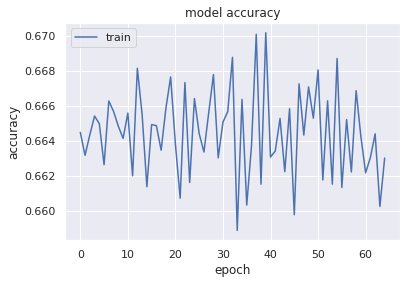

In [ ]:
plt.plot(history2.history['acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

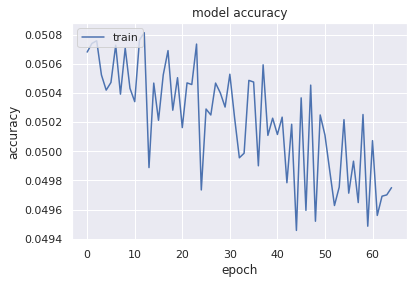

In [ ]:
plt.plot(history2.history['loss'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [ ]:
def read_testimage():
 

In [ ]:
color_cats = []
count = 0
testPath ="/content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/Data/test_set/test_set/cats"
for filename in os.listdir(testPath):
  if(filename.endswith(".jpg")) and (count<=10  ):
    count +=1
    color_cats.append(img_to_array(load_img(testPath +"/" +filename, target_size=(256,256))))
  else:
    break


In [ ]:
color_cats = np.array(color_cats, dtype=float)
gray_cats = gray2rgb(rgb2gray(1.0/255*color_cats))
color_cats = rgb2lab(1.0/255*color_cats)[:,:,:,0]
color_embed = createEmmdeding(color_cats)
color_cats = color_cats.reshape(color_cats.shape+(1,))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  


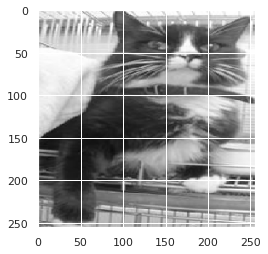

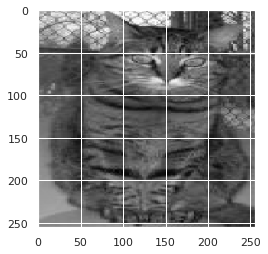

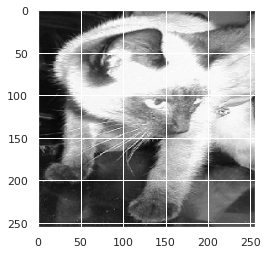

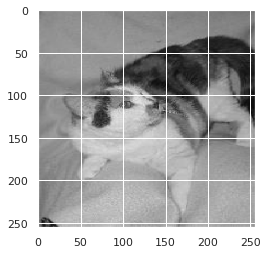

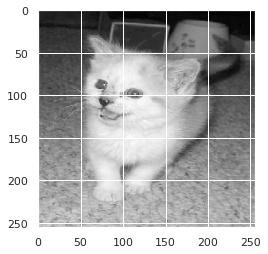

...

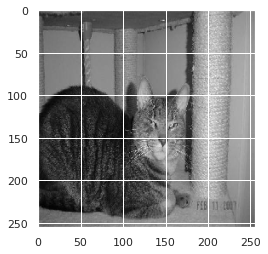

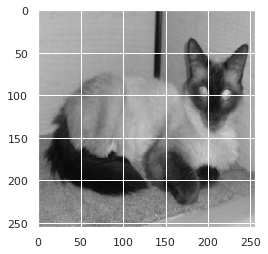

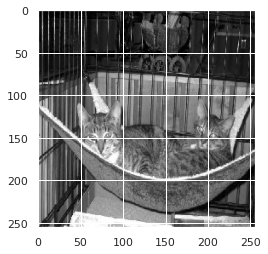

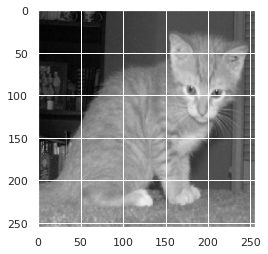

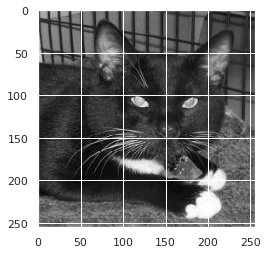

In [ ]:
for i in range(len(gray_cats)):
  plt.imshow(gray_cats[i])
  plt.show()

In [ ]:
# Test model
output_cats = model.predict([color_cats,color_embed])
output_cats = output_cats * 128

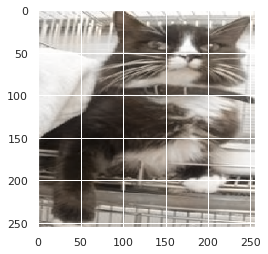

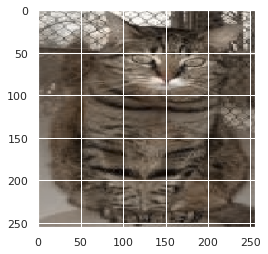

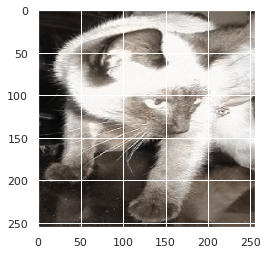

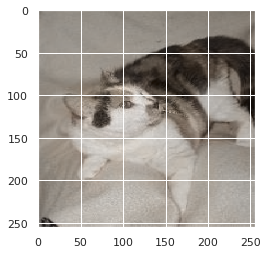

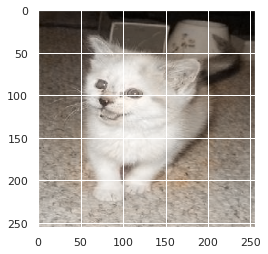

...

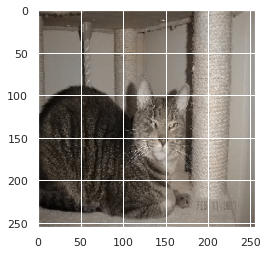

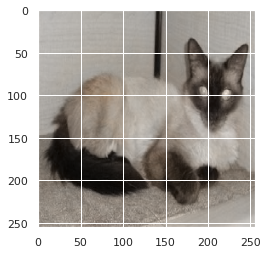

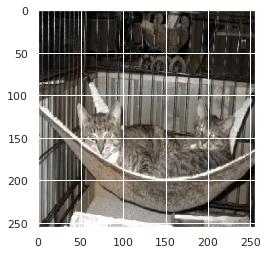

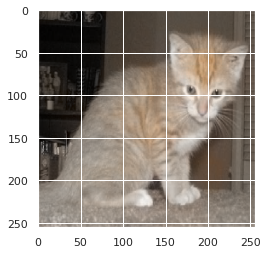

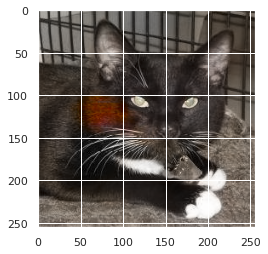

In [ ]:
# Output colorizations
for i in range(len(output_cats)):
    cur = np.zeros((256, 256, 3))
    cur[:,:,0] = color_cats[i][:,:,0]
    cur[:,:,1:] = output_cats[i]
    plt.imshow(lab2rgb(cur))
    plt.show()
    

In [ ]:
#Train model      
model.compile(optimizer = Adam(learning_rate = 0.001), loss = 'mean_absolute_error',
              metrics = ['acc'],run_eagerly=True)
history3 = model.fit(image_a_b_gen(trainGenerator), epochs=500, steps_per_epoch=62,callbacks=callbacks_list,verbose=1,initial_epoch=99)

Epoch 100/500
62/62 [==============================] - ETA: 0s - loss: 0.0496 - acc: 0.6634
Epoch 00100: loss improved from inf to 0.04961, saving model to /content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/models/fusion
INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/models/fusion/assets
62/62 [==============================] - 259s 4s/step - loss: 0.0496 - acc: 0.6634
Epoch 101/500
62/62 [==============================] - ETA: 0s - loss: 0.0498 - acc: 0.6635
Epoch 00101: loss did not improve from 0.04961
62/62 [==============================] - 237s 4s/step - loss: 0.0498 - acc: 0.6635
Epoch 102/500
62/62 [==============================] - ETA: 0s - loss: 0.0496 - acc: 0.6646
Epoch 00102: loss improved from 0.04961 to 0.04956, saving model to /content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/models/fusion
INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/models/fusion/assets
62/62 [==============================] - 240s 4

In [ ]:
color_cats = []
count = 0
testPath ="/content/gdrive/MyDrive/AppliedAI/Cat-Colorizer/Data/test_set/test_set/cats"
for filename in os.listdir(testPath):
    if(filename.endswith(".jpg")) and (count<=20  ):
      count +=1
      color_cats.append(img_to_array(load_img(testPath +"/" +filename, target_size=(256,256))))
    else:
      break


In [ ]:
color_cats = np.array(color_cats, dtype=float)

In [ ]:
gray_cats = gray2rgb(rgb2gray(1.0/255*color_cats))
color_cats = rgb2lab(1.0/255*color_cats)[:,:,:,0]
color_embed = createEmmdeding(color_cats)
color_cats = color_cats.reshape(color_cats.shape+(1,))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  


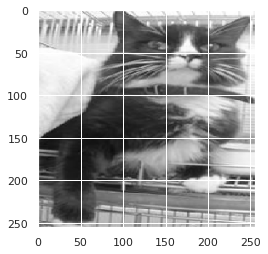

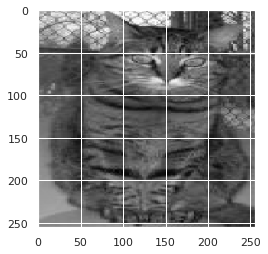

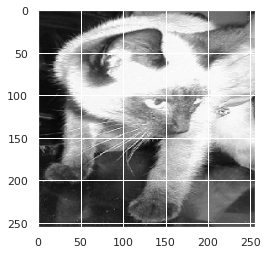

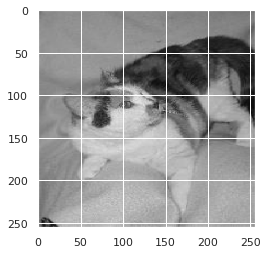

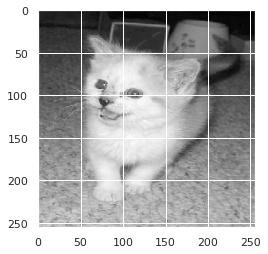

...

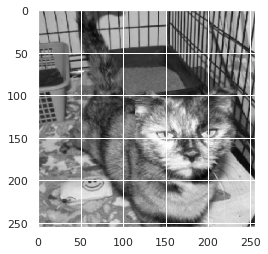

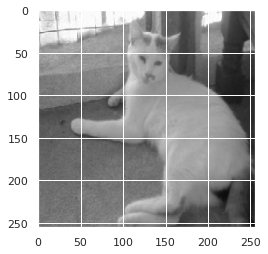

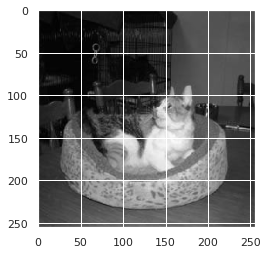

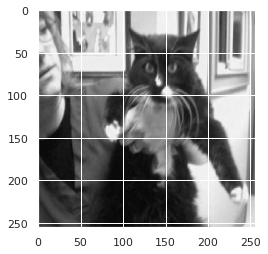

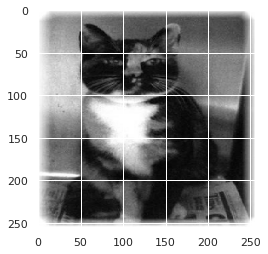

In [ ]:
for i in range(len(gray_cats)):
  plt.imshow(gray_cats[i])
  plt.show()

In [ ]:
# Test model
output_cats = model.predict([color_cats,color_embed])
output_cats = output_cats * 128

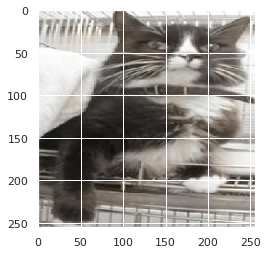

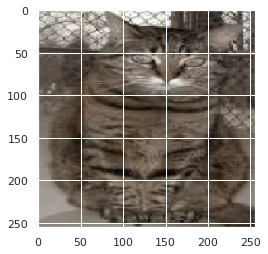

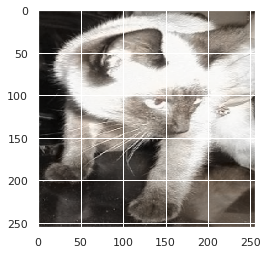

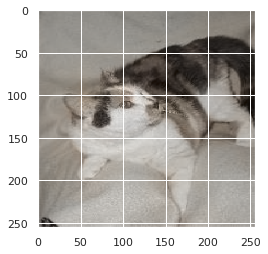

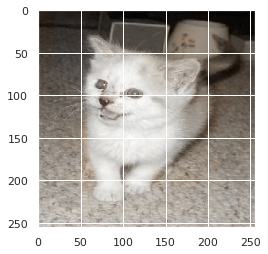

...

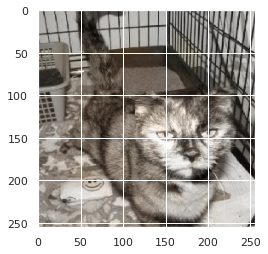

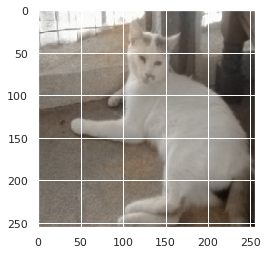

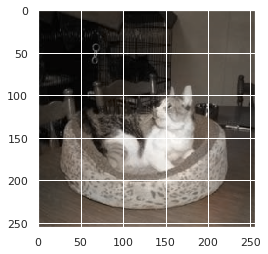

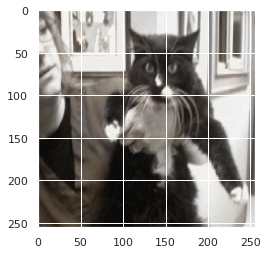

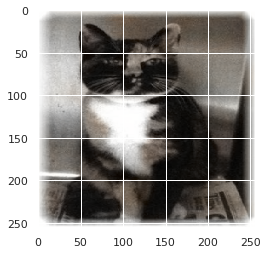

In [ ]:
# Output colorizations
for i in range(len(output_cats)):
    cur = np.zeros((256, 256, 3))
    cur[:,:,0] = color_cats[i][:,:,0]
    cur[:,:,1:] = output_cats[i]
    plt.imshow(lab2rgb(cur))
    plt.show()
    

In [ ]:
#Train model      
model.compile(optimizer = Adam(learning_rate = 0.001), loss = 'mean_absolute_error',
              metrics = ['acc'],run_eagerly=True)
history3 = model.fit(image_a_b_gen(trainGenerator), epochs=500, steps_per_epoch=62,callbacks=callbacks_list,verbose=1,initial_epoch=119)

Epoch 120/500
62/62 [==============================] - ETA: 0s - loss: 0.0493 - acc: 0.6662
Epoch 00120: loss improved from inf to 0.04927, saving model to /content/gdrive/MyDrive/Applied AI/Cat-colorizer/fusion
INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/fusion/assets
62/62 [==============================] - 246s 4s/step - loss: 0.0493 - acc: 0.6662
Epoch 121/500
62/62 [==============================] - ETA: 0s - loss: 0.0493 - acc: 0.6627
Epoch 00121: loss did not improve from 0.04927
62/62 [==============================] - 230s 4s/step - loss: 0.0493 - acc: 0.6627
Epoch 122/500
62/62 [==============================] - ETA: 0s - loss: 0.0494 - acc: 0.6665
Epoch 00122: loss did not improve from 0.04927
62/62 [==============================] - 225s 4s/step - loss: 0.0494 - acc: 0.6665
Epoch 123/500
62/62 [==============================] - ETA: 0s - loss: 0.0492 - acc: 0.6638
Epoch 00123: loss improved from 0.04927 to 0.04920, saving model to /co

In [48]:
testPath ="/content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/test_set/test_set/cats"
def getTestImages(testPath):
  color_cats = []
  count = 0
  for filename in os.listdir(testPath):
    if(filename.endswith(".jpg")) and (count<=20):
      count +=1
      color_cats.append(img_to_array(load_img(testPath +"/" +filename, target_size=(256,256))))
    elif (filename.endswith(".jpg")) and (count>20):
      break
  return color_cats

In [49]:
color_cats = getTestImages(testPath)
color_cats = np.array(color_cats, dtype=float)

In [50]:
def convertTestImages(color_cats):
  gray_cats = gray2rgb(rgb2gray(1.0/255*color_cats))
  color_cats = rgb2lab(1.0/255*color_cats)[:,:,:,0]
  color_embed = createEmmdeding(color_cats)
  color_cats = color_cats.reshape(color_cats.shape+(1,))

  return color_cats,color_embed,gray_cats



In [51]:
color_cats, color_embed,gray_cats = convertTestImages(color_cats)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  


In [52]:
def getPrediction(color_cats,color_embed):
  output_cats = model.predict([color_cats,color_embed])
  output_cats = output_cats * 128
  return output_cats


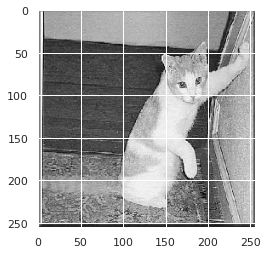

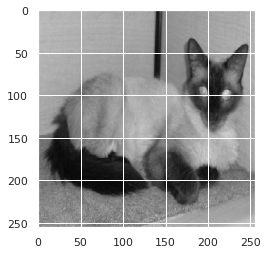

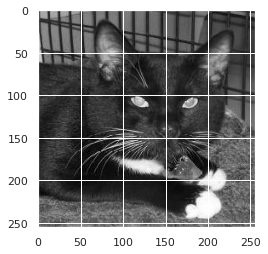

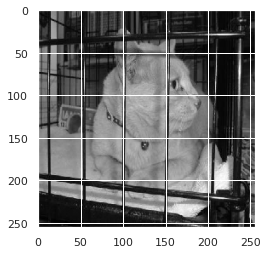

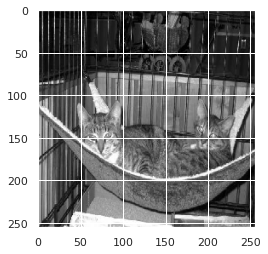

...

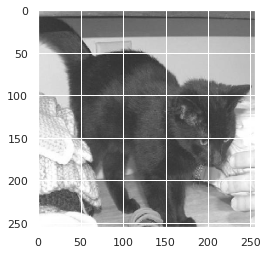

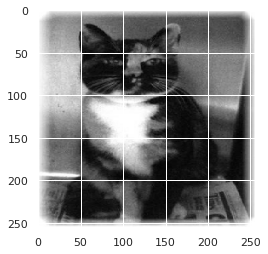

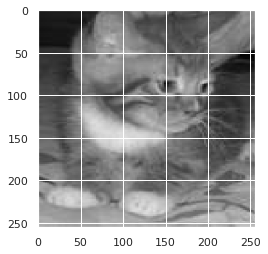

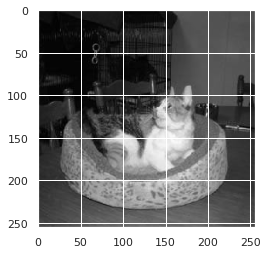

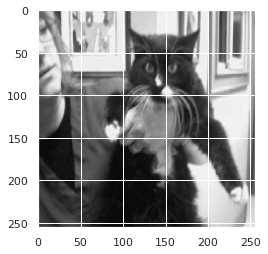

In [53]:
for i in range(len(gray_cats)):
  plt.imshow(gray_cats[i])
  plt.show()

In [54]:
model_output= getPrediction(color_cats,color_embed)

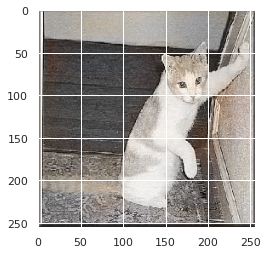

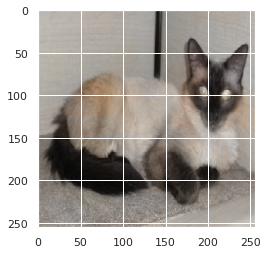

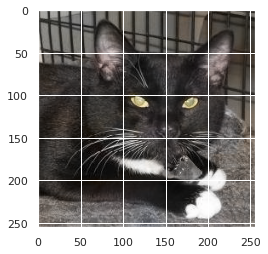

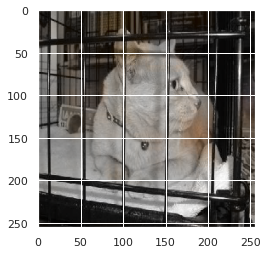

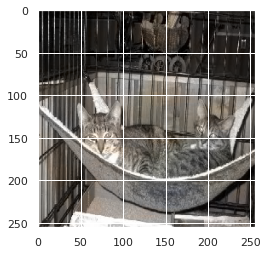

...

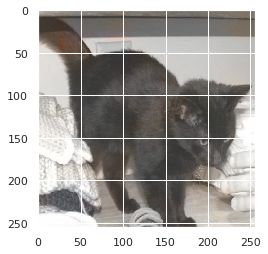

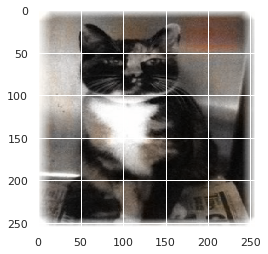

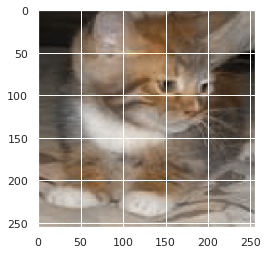

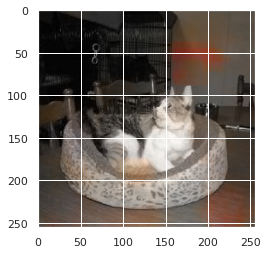

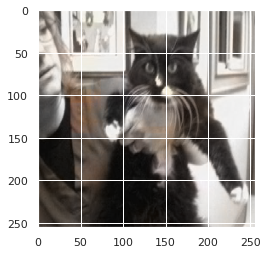

In [55]:
# Output colorizations
for i in range(len(model_output)):
    cur = np.zeros((256, 256, 3))
    cur[:,:,0] = color_cats[i][:,:,0]
    cur[:,:,1:] = model_output[i]
    plt.imshow(lab2rgb(cur))
    plt.show()

In [ ]:
%load_ext tensorboard

In [71]:
%reload_ext tensorboard

In [73]:
model.save("/content/gdrive/MyDrive/Applied AI/Cat-colorizer/model")

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Applied AI/Cat-colorizer/model/assets


## Part Testing

In [153]:


%tensorboard --logdir="/content/gdrive/MyDrive/Applied AI/Cat-colorizer/log/train"

<IPython.core.display.Javascript object>

In [134]:
def getTestImages(testPath):
  imageArray = []
  for i in range(0,10):
    num_test_img = random.randint(4000,5000)
    file = img_to_array(load_img(f"/content/gdrive/MyDrive/Applied AI/Cat-colorizer/data/test_set/test_set/cats/cat.{num_test_img}.jpg",target_size=(image_size,image_size)))
    imageArray.append(file)
  return imageArray

In [135]:
testImages = getTestImages(testPath)

In [136]:
def convertTestImages(color_cats):
  color_cats = np.array(color_cats,dtype=float)
  gray_cats = gray2rgb(rgb2gray(1.0/255*color_cats))
  color_cats = rgb2lab(1.0/255*color_cats)[:,:,:,0]
  color_embed = createEmmdeding(color_cats)
  color_cats = color_cats.reshape(color_cats.shape+(1,))

  return color_cats,color_embed,gray_cats


In [137]:
color_cats, color_embed,gray_cats = convertTestImages(testImages)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  


In [138]:
def getPrediction(color_cats,color_embed):
  output_cats = model.predict([color_cats,color_embed])
  output_cats = output_cats * 128
  return output_cats


In [139]:
model_output= getPrediction(color_cats,color_embed)

In [142]:
# Output colorizations
def showResults(model_output):
  for i in range(len(model_output)):
      plt.figure(figsize=(10,10))
      or_image = plt.subplot(3,3,1)
      or_image.set_title('Grayscale Input', fontsize=16)
      plt.imshow( gray_cats[i].reshape((256, 256,3)) , cmap='gray' )

      cur = np.zeros((256, 256, 3))
      cur[:,:,0] = color_cats[i][:,:,0]
      cur[:,:,1:] = model_output[i]
      
      or_image = plt.subplot(3,3,2)
      or_image.set_title('Predicted Input', fontsize=16)
      plt.imshow( lab2rgb(cur) )
      plt.imshow(lab2rgb(cur))
      
      ou_image = plt.subplot(3,3,3)
      image = Image.fromarray( ( testImages[i]).astype( 'uint8' )  )
      ou_image.set_title('Ground Truth', fontsize=16)
      plt.imshow( image )

      plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  


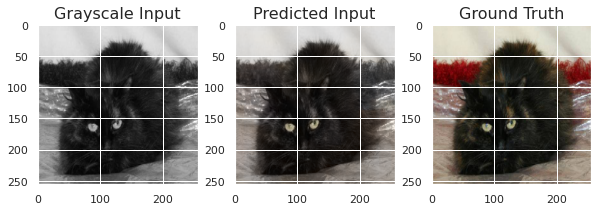

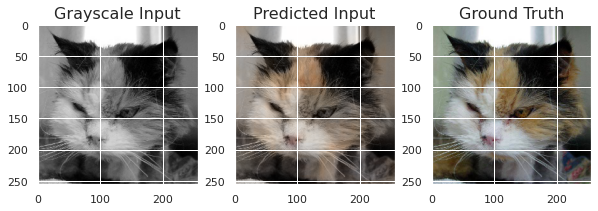

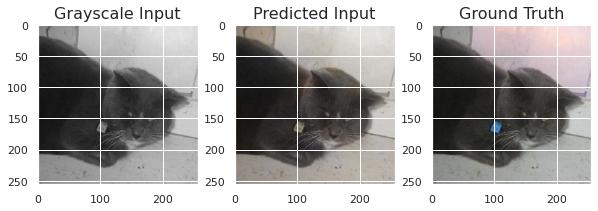

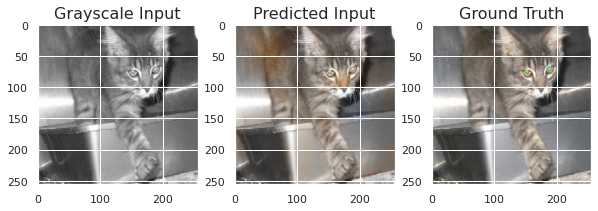

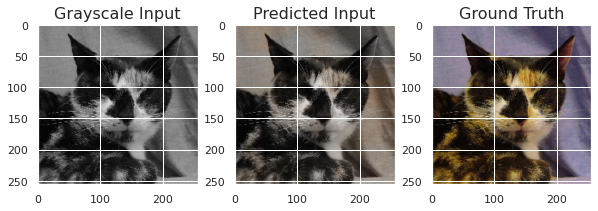

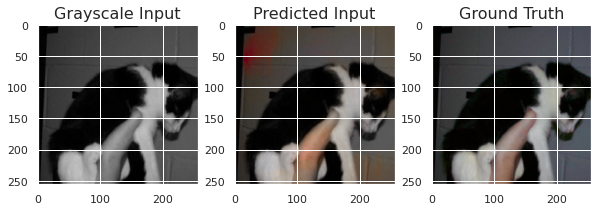

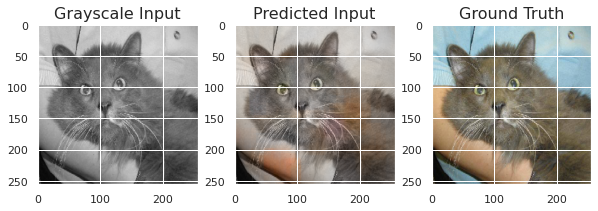

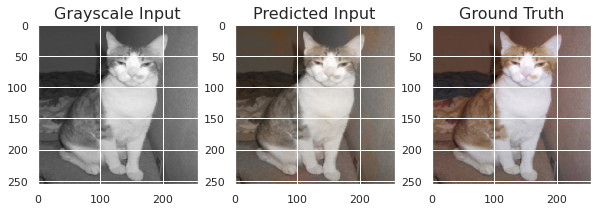

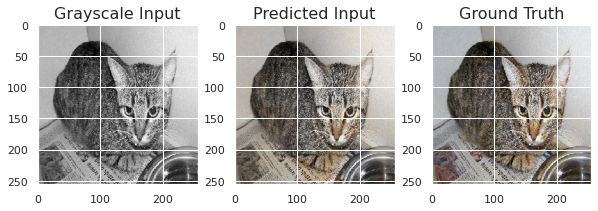

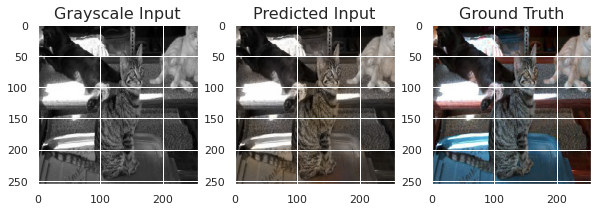

In [150]:
testImages = getTestImages(testPath)
color_cats, color_embed,gray_cats = convertTestImages(testImages)
model_output= getPrediction(color_cats,color_embed)
showResults(model_output)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  


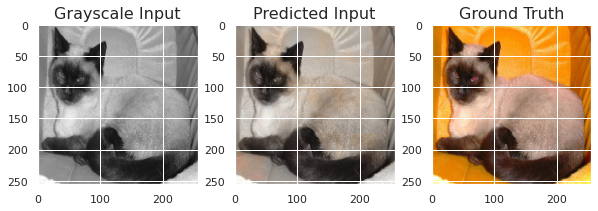

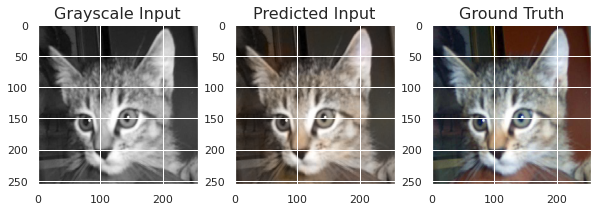

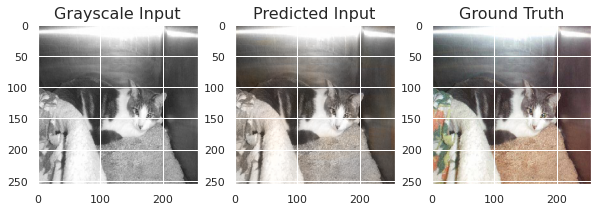

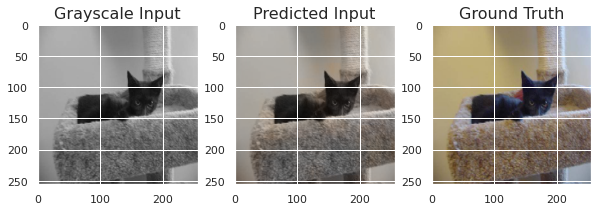

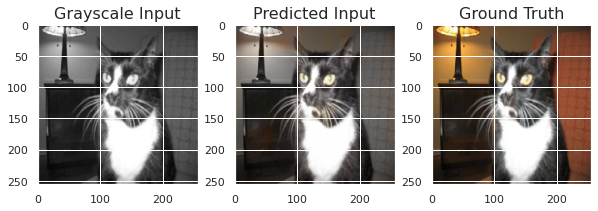

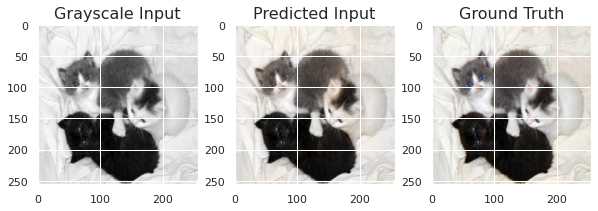

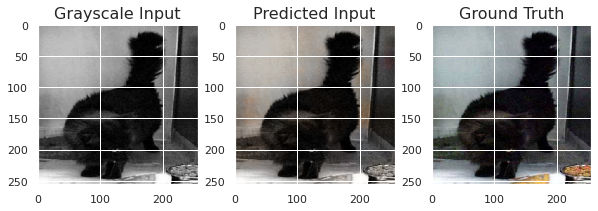

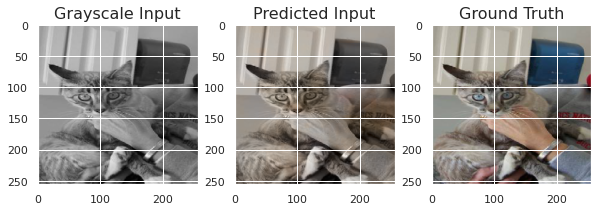

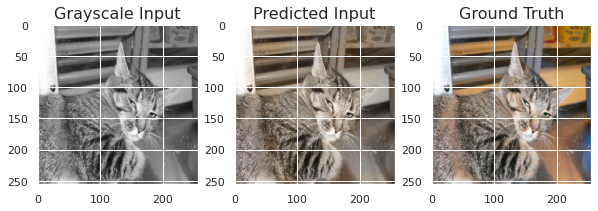

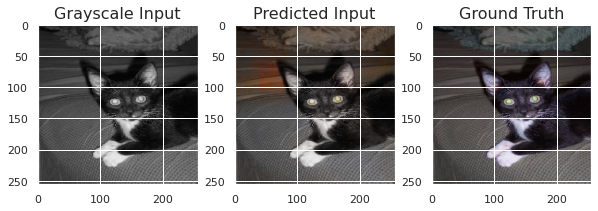

In [152]:
testImages = getTestImages(testPath)
color_cats, color_embed,gray_cats = convertTestImages(testImages)
model_output= getPrediction(color_cats,color_embed)
showResults(model_output)